In [7]:
from Library import *
from Data_Preparation import *
from Data_Preparation2 import *
import folium 
import scipy
import sklearn
from IPython.display import display
from sklearn import preprocessing
from itertools import combinations
import pickle
from sklearn import decomposition
from icecream import ic 
import os
from tqdm import tqdm
import requests
import nbimporter
from datetime import datetime
from sklearn.mixture import GaussianMixture
from sklearn.metrics import roc_curve, auc , roc_auc_score, r2_score, accuracy_score , silhouette_score
from sklearn.model_selection import GridSearchCV
from catboost import CatBoostClassifier
from sklearn.neural_network import MLPClassifier
import json
from datetime import datetime, time
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.cluster import DBSCAN
from IPython.display import Markdown, display
import geopandas as gpd
from shapely.geometry import Point
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
def printmd(string, color=None):
    colorstr = "<span style='color:{}'>{}</span>".format(color, string)
    display(Markdown(colorstr))
pd.options.mode.chained_assignment = None
import warnings
warnings.filterwarnings('ignore')

In [10]:
class drives:
    def __init__(self, car_id, agg_df, dict_sum, dict_cor, dict_drives, all_drives,
                 df, neigh_dict, groups_ts, splitted_ts_groups, scaling_parameters,
                 dict_length, new_dict, groups_splitted_normlized_ts, df_spectral):
        self.car_id = car_id #id of the car 
        self.agg_df = agg_df #aggregated df for pattern detection
        self.dict_sum = dict_sum #shows how many drives for each group 
        self.dict_cor = dict_cor #show the end coordinate for each group 
        self.dict_drives = dict_drives #saves the drives as ts for each group
        self.all_drives = all_drives #list of all the drives as ts 
        self.df = df #metadata of the drives
        self.neigh_dict = neigh_dict #map each group to its destination neighberhood
        self.groups_ts = groups_ts #dict that contains ts of each group 
        self.splitted_ts_groups = splitted_ts_groups #dict that contains segmented ts of each group 
        self.scaling_parameters = scaling_parameters #dict that helps standetize the ts 
        self.dict_length = dict_length #ts sorted by their lengths
        self.new_dict = new_dict
        self.groups_splitted_normlized_ts = groups_splitted_normlized_ts #ts divided into groups after segmented and standetize
        self.df_spectral = df_spectral #metrix that shows the probability for each group to be the same driver


In [11]:
import random
def calculate_stats_for_largest_cluster(df):
    group_stats = {}
    
    for group in df['group'].unique():
        group_data = df[df['group'] == group]
        dbscan = DBSCAN(eps=1, min_samples=5)
        dbscan_labels = dbscan.fit_predict(group_data[['PC1','PC2', 'PC3','PC4','PC5']])

        # Add DBSCAN labels to the DataFrame
        group_data['dbscan_label'] = dbscan_labels
        # Get the largest cluster
        largest_cluster_label = group_data['dbscan_label'].value_counts().idxmax()
        largest_cluster = group_data[group_data['dbscan_label'] == largest_cluster_label]

        # Calculate mean and std of features in the largest cluster
        group_stats[group] = {
            'mean': largest_cluster[['PC1','PC2', 'PC3','PC4','PC5']].mean().values,
            'std': largest_cluster[['PC1','PC2', 'PC3','PC4','PC5']].std().values
        }

    return group_stats

In [12]:
def transform_rocket(dict_length ,label =1 ):    
    def convert_dfs_to_arrays(df_list):
        """Convert list of DataFrames to numpy arrays."""
        arrays = []
        labels = []
        for df in df_list:
            arrays.append(df[['speed', 'acceleration_est_1', 'angular_acc']].values.T)  # Shape: (num_features, num_timesteps)
            labels.append(df.iloc[0]['group'])
        return np.stack(arrays, axis=0), labels

    t_labels = []  # True labels
    X_transformed_list = []  # List to store transformed arrays

    # Transform each DataFrame in dict_length using MiniRocket
    for key in dict_length:
   
        if key<9:
            continue
        arrays, true_labels = convert_dfs_to_arrays(dict_length[key])
        t_labels += true_labels

        # Create and fit the MiniRocket transformer
        rocket = MiniRocketMultivariate(num_kernels=10000, random_state=int(100))
        rocket.fit(arrays)

        # Transform the data and store it
        X_transformed = rocket.transform(arrays)
        X_transformed_list.append(X_transformed)

    # Concatenate all transformed arrays along the first axis
    X_transformed_all = np.concatenate(X_transformed_list, axis=0)

    # Apply PCA to reduce dimensions to 3 components
    pca = PCA(n_components=15)
    X_pca = pca.fit_transform(X_transformed_all)
    df_pca = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3','PC4', 'PC5', 'PC6','PC7', 'PC8', 'PC9','PC10', 'PC11', 'PC12','PC13','PC14','PC15'])

    return df_pca

In [13]:
import pandas as pd
import numpy as np
from sktime.transformations.panel.rocket import MiniRocketMultivariate
from sklearn.cluster import SpectralClustering
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA

def compute_cluster(neighbors_dict, dict_length, rand=100):
    """
    Computes clusters using MiniRocket transformation, PCA, and Spectral Clustering.
    Returns the labels for Spectral Clustering.
    """
    spectral_matrix = np.zeros((len(neigh_dict), len(neigh_dict)))
    
    def convert_dfs_to_arrays(df_list):
        """Convert list of DataFrames to numpy arrays."""
        arrays = []
        labels = []
        for df in df_list:
            arrays.append(df[['speed', 'acceleration_est_1', 'angular_acc']].values.T)  # Shape: (num_features, num_timesteps)
            labels.append(df.iloc[0]['group']-1)
        return np.stack(arrays, axis=0), labels

    t_labels = []  # True labels
    X_transformed_list = []  # List to store transformed arrays

    # Transform each DataFrame in dict_length using MiniRocket
    for key in dict_length:
        arrays, true_labels = convert_dfs_to_arrays(dict_length[key])
        t_labels += true_labels
        
        # Create and fit the MiniRocket transformer
        rocket = MiniRocketMultivariate(num_kernels=10000, random_state=int(rand))
        rocket.fit(arrays)

        # Transform the data and store it
        X_transformed = rocket.transform(arrays)
        X_transformed_list.append(X_transformed)

    # Concatenate all transformed arrays along the first axis
    X_transformed_all = np.concatenate(X_transformed_list, axis=0)

    # Apply PCA to reduce dimensions to 3 components
    pca = PCA(n_components=5)
    X_pca = pca.fit_transform(X_transformed_all)
    df_pca = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3', 'PC4', 'PC5'])
    df_pca['group'] = t_labels

    # Calculate statistics for the largest cluster
    group_stats = calculate_stats_for_largest_cluster(df_pca)

    # Extract means for clustering
    X_means = np.array([stats['mean'] for stats in group_stats.values()])
    group_labels = list(group_stats.keys())

    def evaluate_spectral_clustering(X):
    
        silhouette_scores_spectral = []

#         for k in range(2, len(neigh_dict)-1):
        for k in range(2, len(neigh_dict)):
            # Spectral Clustering
            spectral = SpectralClustering(n_clusters=k, random_state=42)
            spectral_labels = spectral.fit_predict(X)

            # Check if there is more than one unique label
            if len(set(spectral_labels)) > 1:
                # Calculate silhouette score only if there is more than one unique cluster
                silhouette_scores_spectral.append(silhouette_score(X, spectral_labels))
            else:
                # Append a placeholder score (e.g., -1) if only one cluster is found
                silhouette_scores_spectral.append(-1)

        return silhouette_scores_spectral
    # Evaluate silhouette scores for Spectral Clustering
    silhouette_scores_spectral = evaluate_spectral_clustering(X_means)

    # Determine the best k for Spectral Clustering based on silhouette scores
    best_k_spectral = np.argmax(silhouette_scores_spectral) + 2

    # Apply Spectral Clustering with the best k
    spectral_labels = SpectralClustering(n_clusters=best_k_spectral, random_state=42).fit_predict(X_means)

    return spectral_labels

In [14]:
mitzubishi_ids =[460631,379771, 382464, 386627, 387960, 424306, 444040, 448174, 450593, 450601, 450603, 454751, 472233, 472239, 473235, 486347, 493989, 493992]

In [15]:
lst_car=[]
for v in mitzubishi_ids:
    
    file_path = f"/bigdata/users-home/dor/transpotation research/agg_data/drives_instances/{v}.pkl"

    if os.path.exists(file_path):
        with open(file_path, "rb") as file:
            drive_instance = pickle.load(file)
        print(f"Loaded object for car_id: {drive_instance.car_id}")
        lst_car.append(drive_instance)
    else:
        print(f"File not found: {file_path}")

Loaded object for car_id: 460631
Loaded object for car_id: 379771
Loaded object for car_id: 382464
Loaded object for car_id: 386627
Loaded object for car_id: 387960
Loaded object for car_id: 424306
Loaded object for car_id: 444040
Loaded object for car_id: 448174
Loaded object for car_id: 450593
Loaded object for car_id: 450601
Loaded object for car_id: 450603
Loaded object for car_id: 454751
Loaded object for car_id: 472233
Loaded object for car_id: 472239
Loaded object for car_id: 473235
File not found: /bigdata/users-home/dor/transpotation research/agg_data/drives_instances/486347.pkl
Loaded object for car_id: 493989
Loaded object for car_id: 493992


In [16]:
tresh = 0.912
for obj in lst_car:
    obj.clusters = {}
    df_spectral = obj.df_spectral.data if hasattr(obj.df_spectral, 'data') else obj.df_spectral  # Handle styled DataFrame
    visited = set()
    try:
        # Iterate over groups (index) to find clusters
        for group in df_spectral.index:
            if group in visited:
                continue  # Skip already clustered groups

            # Find all groups with similarity >= tresh
            high_sim_groups = [g for g in df_spectral.columns if df_spectral.at[group, g] >= tresh and g not in visited]

            # Check if the group has no high similarity connections
            if len(high_sim_groups) == 1:  # The group itself
                # Check borderline similarities
                borderline_groups = [g for g in df_spectral.columns if (1 - tresh) < df_spectral.at[group, g] < tresh]

                if len(borderline_groups) > 0:
                    # Ignore this group (as it has borderline connections)
                    continue
                else:
                    # Form a single cluster for this group
                    cluster_id = len(obj.clusters) + 1
                    obj.clusters[cluster_id] = [group]
                    visited.add(group)
            elif len(high_sim_groups) > 1:
                # Validate all groups in high_sim_groups are compatible
                valid_cluster = True
                for g1 in high_sim_groups:
                    for g2 in high_sim_groups:
                        if g1 != g2 and df_spectral.at[g1, g2] < tresh:
                            valid_cluster = False
                            break
                    if not valid_cluster:
                        break

                if valid_cluster:
                    # Form a cluster for groups with high similarity
                    cluster_id = len(obj.clusters) + 1
                    obj.clusters[cluster_id] = high_sim_groups
                    visited.update(high_sim_groups)
                else:
                    # Ignore the group as it doesn't fit a valid cluster
                    visited.add(group)

        # Print or debug the clusters for this obj
        print(f"Clusters for car {obj.car_id}: {obj.clusters}")
    except Exception as e:
        print(f"Error processing car {obj.car_id}: {e}")
        continue


Clusters for car 460631: {1: ['Hadar Yosef', 'Neot Afeka A', 'Rom 2000', 'Herzliya B'], 2: ['Tel Aviv University', 'HaOgen']}
Clusters for car 379771: {1: ['Citi', '2004', 'Herzliya B'], 2: ['Shikun Ovdim', 'Kiryat Etgarim']}
Clusters for car 382464: {1: ['Neve Zeev', 'Ramot B', 'Ramot'], 2: ['Gimel', 'City Center']}
Clusters for car 386627: {1: ['Ramot Menachem', 'Sgula'], 2: ['Ramat Siv Industrial Zone', 'Magdiel']}
Clusters for car 387960: {1: ['Shikun Vatikim'], 2: ['German Colony', 'HaParpar'], 3: ['Givat HaRakafot', 'Kiriat HaMemshalah Rabin', 'Sderot Weizmann']}
Error processing car 424306: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().
Clusters for car 444040: {1: ['Em Hamoshavot hadasha', 'Circle Road', 'Kiryat Aryeh Industrial Zone'], 2: ['Mahane Yehuda', 'Yaaf', 'Sgula']}
Clusters for car 448174: {1: ['Ramat Siv Industrial Zone', 'Ramot Menachem'], 2: ['Glilot']}
Clusters for car 450593: {1: ['Ramot Alef', 'Ramot'], 2: ['Ramot 

In [9]:
df = lst_car[0].df

In [17]:

for obj in lst_car:
    obj.drivers = {}
    for group in obj.neigh_dict:
        for cluster in obj.clusters:
            if obj.neigh_dict[group] in obj.clusters[cluster]:
                obj.drivers[cluster] = obj.drivers.get(cluster,[])
                obj.drivers[cluster] += obj.groups_splitted_normlized_ts[group]

In [18]:
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN

def normalize_time_series(df_list, eps=10, min_samples=20):
    """
    Normalize time series data in a list of DataFrames.
    
    Filters drives where any row has an outlier in angular acceleration, applies DBSCAN clustering,
    and normalizes each time series within its cluster.

    Parameters:
        df_list (list): List of pandas DataFrames containing time series data.
        eps (float): The maximum distance between two samples for them to be considered as in the same neighborhood (DBSCAN).
        min_samples (int): The number of samples in a neighborhood for a point to be considered a core point (DBSCAN).
        
    Returns:
        list: List of normalized pandas DataFrames.
    """
    # Ensure all DataFrames in the list have the same shape by resetting their indices
    for df in df_list:
        df.reset_index(inplace=True, drop=True)


   
    # Step 2: Apply DBSCAN clustering
    # Compute drive-level features for clustering
    drive_features = []
    for df in df_list:
        features = [
            df['speed'].mean(),
            df['acceleration_est_1'].mean(),
            df['angular_acc'].mean(),
            df['speed'].std(),
            df['acceleration_est_1'].std(),
            df['angular_acc'].std()
        ]
        drive_features.append(features)
    
    drive_features = np.array(drive_features)
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    cluster_labels = dbscan.fit_predict(drive_features)
    
    # Assign clusters to each drive
    clustered_drives = {}
    for label, df in zip(cluster_labels, df_list):
        if label != -1:  # Ignore noise points
            if label not in clustered_drives:
                clustered_drives[label] = []
            clustered_drives[label].append(df)
    
    # Step 3: Normalize each time series within its cluster
    normalized_list = []
    for cluster, drives in clustered_drives.items():
        # Concatenate all drives in the cluster to calculate mean and std
        concatenated = pd.concat(drives, axis=0)
        columns_of_interest = ['speed', 'acceleration_est_1', 'angular_acc']
        cluster_mean = concatenated[columns_of_interest].mean()
        cluster_std = concatenated[columns_of_interest].std().replace(0, 1)  # Replace zero std with one
        
        # Normalize each drive in the cluster
        for df in drives:
            if df.iloc[0].speed > 0  :
                continue
            normalized_df = df.copy()
            for col in columns_of_interest:
                normalized_df[col] = (normalized_df[col] - cluster_mean[col]) / cluster_std[col]
            normalized_list.append(normalized_df)

    # Return the list of normalized DataFrames
    return normalized_list




drive_id_for_each_driver = {}
for driver in lst_car[0].drivers:
    for series  in lst_car[0].drivers[driver]:
        drive_id_for_each_driver[driver] = drive_id_for_each_driver.get(driver,[])
        drive_id_for_each_driver[driver].append(series.iloc[0].drive_id)
        
for key in lst_car[0].new_dict:
    for series in lst_car[0].new_dict[key]:
        for driver in drive_id_for_each_driver:
            if series.iloc[0].drive_id in drive_id_for_each_driver[driver]:
                series['group'] = driver
groups_splitted_normlized_ts = {}
for key in lst_car[0].new_dict:
    lst = normalize_time_series(lst_car[0].new_dict[key])
    for series in lst:
        group_num = int(series.iloc[0][['group']])
        groups_splitted_normlized_ts[group_num] = groups_splitted_normlized_ts.get(group_num,[])
        groups_splitted_normlized_ts[group_num].append(series)

In [19]:
groups_splitted_normlized_ts.keys()

dict_keys([1, 2, 3])

In [20]:
lst_car[0].drivers[1][0].iloc[0].drive_id

12867037216

In [21]:
def remove_outliers_with_3std(ts_list):
    """
    Removes outliers from a list of time series using the ±3 standard deviation rule.
    
    Parameters:
        ts_list: List of pandas DataFrames, each representing a time series.

    Returns:
        Filtered list of time series, excluding outliers.
    """
    # Ensure all elements are valid DataFrames
    if not all(isinstance(ts, pd.DataFrame) for ts in ts_list):
        raise ValueError("All elements in ts_list must be pandas DataFrames.")
    
    # Filter out empty DataFrames
    ts_list = [ts[["speed", "acceleration_est_1", "angular_acc"]] for ts in ts_list if not ts.empty]
    if not ts_list:
        raise ValueError("All time series are empty.")

    # Ensure consistent shapes for all DataFrames
    n_rows = ts_list[0].shape[0]
    ts_list = [ts for ts in ts_list if ts.shape[0] == n_rows]
    if len(ts_list) < 2:
        raise ValueError("Not enough time series with consistent shapes.")

    # Flatten ts_list into a 2D array (time series as rows, features as columns)
    flattened_ts = np.array([ts.values.flatten() for ts in ts_list])
    if flattened_ts.ndim != 2:
        raise ValueError("Data must be 2D: one row per time series, one column per feature.")

    # Calculate mean and std for each feature
    mean = np.mean(flattened_ts, axis=0)
    std = np.std(flattened_ts, axis=0)

    # Identify inliers
    mask = np.all(
        (flattened_ts >= (mean - 2.5 * std)) & (flattened_ts <= (mean + 2.5 * std)),
        axis=1
    )

    # Filter and return only inlier time series
    filtered_ts = [ts_list[i] for i in range(len(ts_list)) if mask[i]]
    return filtered_ts

from sklearn.cluster import DBSCAN
import pandas as pd
import numpy as np

def remove_outliers_with_dbscan(ts_list, eps=2, min_samples=10):
    """
    Removes outliers from a list of time series using DBSCAN clustering.

    Parameters:
        ts_list: List of pandas DataFrames, each representing a time series.
        eps: Maximum distance between two samples for them to be considered in the same neighborhood (DBSCAN parameter).
        min_samples: Minimum number of samples in a neighborhood for a point to be considered a core point (DBSCAN parameter).

    Returns:
        Filtered list of time series, excluding outliers.
    """
    # Ensure all elements are valid DataFrames
    if not all(isinstance(ts, pd.DataFrame) for ts in ts_list):
        raise ValueError("All elements in ts_list must be pandas DataFrames.")
    
    # Filter out empty DataFrames
    ts_list = [ts[["speed", "acceleration_est_1", "angular_acc"]] for ts in ts_list if not ts.empty]
    if not ts_list:
        raise ValueError("All time series are empty.")

    # Ensure consistent shapes for all DataFrames
    n_rows = ts_list[0].shape[0]
    ts_list = [ts for ts in ts_list if ts.shape[0] == n_rows]
    if len(ts_list) < 2:
        raise ValueError("Not enough time series with consistent shapes.")

    # Flatten ts_list into a 2D array (time series as rows, features as columns)
    flattened_ts = np.array([ts.values.flatten() for ts in ts_list])
    if flattened_ts.ndim != 2:
        raise ValueError("Data must be 2D: one row per time series, one column per feature.")

    # Apply DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    cluster_labels = dbscan.fit_predict(flattened_ts)

    # Filter out noise points (outliers have a cluster label of -1)
    inlier_indices = np.where(cluster_labels == -1)[0]
    filtered_ts = [ts_list[i] for i in inlier_indices]

    return filtered_ts


In [22]:
import pandas as pd
import numpy as np
from fastdtw import fastdtw
from scipy.spatial.distance import euclidean, cosine

# Function to calculate the centroid of a group of time series
def calculate_centroid(time_series_list):
    length = max(len(ts) for ts in time_series_list)
    interpolated = [ts.reindex(range(length), method='nearest', fill_value=0).values for ts in time_series_list]
    centroid = np.mean(interpolated, axis=0)
    return centroid

# Function to calculate the mean distance to centroid with both metrics
def calculate_mean_distance_to_centroid(ts_list, centroid, metric):
    distances = [fastdtw(ts.values, centroid, dist=metric)[0] for ts in ts_list]
    return np.mean(distances)

# Updated code to calculate both metrics and include inter- and intra-group analysis
result_df = pd.DataFrame(columns=[
    'Object_ID', 'Group', 'Metric', 'Mean_Distance_To_Self', 'Mean_Distance_To_Other'
])

# Process each object in lst_car
for obj_idx, obj in enumerate(lst_car):
    drivers = obj.drivers
    driver_groups = list(drivers.keys())

    group_results = []

    for group in driver_groups:
        # Retrieve and clean time series
        ts_list = [ts[["speed", "acceleration_est_1", "angular_acc"]] for ts in drivers[group]]
        ts_list = remove_outliers_with_3std(ts_list)

        # Calculate centroid for the group
        group_centroid = calculate_centroid(ts_list)

        for metric, metric_name in [(euclidean, 'Euclidean'), (cosine, 'Cosine')]:
            # Calculate mean distance to own centroid
            mean_distance_to_self = calculate_mean_distance_to_centroid(ts_list, group_centroid, metric)

            # Calculate mean distance to other groups' centroids
            distances_to_other_centroids = []

            for other_group in driver_groups:
                if other_group != group:
                    other_ts_list = [ts[["speed", "acceleration_est_1", "angular_acc"]] for ts in drivers[other_group]]
                    other_ts_list = remove_outliers_with_3std(other_ts_list)
                    other_group_centroid = calculate_centroid(other_ts_list)
                    distances_to_other_centroids.append(
                        calculate_mean_distance_to_centroid(ts_list, other_group_centroid, metric)
                    )

            mean_distance_to_other = np.mean(distances_to_other_centroids) if distances_to_other_centroids else None

            # Append results
            group_results.append({
                'Object_ID': obj_idx,
                'Group': group,
                'Metric': metric_name,
                'Mean_Distance_To_Self': mean_distance_to_self,
                'Mean_Distance_To_Other': mean_distance_to_other
            })

    result_df = result_df.append(group_results, ignore_index=True)

# Display results
import ace_tools_open as tools

result_df = result_df.round(3)  # Optional rounding for cleaner display
tools.display_dataframe_to_user(name="Mean Distance Analysis with Metrics", dataframe=result_df)


Mean Distance Analysis with Metrics


In [24]:
import pandas as pd
import numpy as np

# Assuming `result_df` is the DataFrame containing the result table
# Columns: 'Object_ID', 'Group', 'Metric', 'Mean_Distance_To_Self', 'Mean_Distance_To_Other'

# Filter the baseline for the first object
baseline_object_id = 0
baseline_df = result_df[result_df['Object_ID'] == baseline_object_id]

# Prepare a table to compare all other objects against the baseline
comparison_results = []

# Iterate through all objects except the baseline
for obj_id in result_df['Object_ID'].unique():
    if obj_id == baseline_object_id:
        continue  # Skip the baseline object

    # Filter results for the current object
    current_object_df = result_df[result_df['Object_ID'] == obj_id]

    # Compare with the baseline for each metric
    for metric in ['Euclidean', 'Cosine']:
        baseline_metric_df = baseline_df[baseline_df['Metric'] == metric]
        current_metric_df = current_object_df[current_object_df['Metric'] == metric]

        # Calculate ratio-based differences for intra-group and inter-group distances
        for _, baseline_row in baseline_metric_df.iterrows():
            group = baseline_row['Group']
            baseline_self = baseline_row['Mean_Distance_To_Self']
            baseline_other = baseline_row['Mean_Distance_To_Other']

            # Find matching group in current object
            current_row = current_metric_df[current_metric_df['Group'] == group]

            if not current_row.empty:
                current_self = current_row['Mean_Distance_To_Self'].values[0]
                current_other = current_row['Mean_Distance_To_Other'].values[0]

                # Calculate ratios to avoid biases
                baseline_ratio = baseline_self / baseline_other if baseline_other != 0 else np.nan
                current_ratio = current_self / current_other if current_other != 0 else np.nan

                comparison_results.append({
                    'Object_ID': obj_id,
                    'Group': group,
                    'Metric': metric,
                    'Self_to_Other_Ratio_Difference': current_ratio - baseline_ratio
                })

# Create a DataFrame for the comparison results
comparison_df = pd.DataFrame(comparison_results)

# Analyze accuracy based on ratio differences
# Example: Objects with minimal ratio differences are more similar to the baseline
comparison_df['Accuracy_Score'] = 1 / (1 + comparison_df['Self_to_Other_Ratio_Difference'].abs())

# Aggregate results to assess accuracy per object
accuracy_summary = comparison_df.groupby('Object_ID')['Accuracy_Score'].mean().reset_index()
accuracy_summary.columns = ['Object_ID', 'Average_Accuracy_Score']

# Sort by accuracy for interpretation
accuracy_summary = accuracy_summary.sort_values(by='Average_Accuracy_Score', ascending=False)

# Display results
import ace_tools_open as tools

tools.display_dataframe_to_user(name="Comparison of Accuracy by Object (Ratio-Based)", dataframe=accuracy_summary)


Comparison of Accuracy by Object (Ratio-Based)


In [25]:
import pandas as pd
import numpy as np

# Assuming `result_df` is the DataFrame containing the result table
# Columns: 'Object_ID', 'Group', 'Metric', 'Mean_Distance_To_Self', 'Mean_Distance_To_Other'

# Filter the baseline for the first object
baseline_object_id = 0
baseline_df = result_df[result_df['Object_ID'] == baseline_object_id]

# Prepare a table to compare all other objects against the baseline
comparison_results = []

# Iterate through all objects except the baseline
for obj_id in result_df['Object_ID'].unique():
    if obj_id == baseline_object_id:
        continue  # Skip the baseline object

    # Filter results for the current object
    current_object_df = result_df[result_df['Object_ID'] == obj_id]

    # Compare with the baseline for each metric
    for metric in ['Euclidean', 'Cosine']:
        baseline_metric_df = baseline_df[baseline_df['Metric'] == metric]
        current_metric_df = current_object_df[current_object_df['Metric'] == metric]

        # Calculate ratio-based differences for intra-group and inter-group distances
        for _, baseline_row in baseline_metric_df.iterrows():
            group = baseline_row['Group']
            baseline_self = baseline_row['Mean_Distance_To_Self']
            baseline_other = baseline_row['Mean_Distance_To_Other']

            # Find matching group in current object
            current_row = current_metric_df[current_metric_df['Group'] == group]

            if not current_row.empty:
                current_self = current_row['Mean_Distance_To_Self'].values[0]
                current_other = current_row['Mean_Distance_To_Other'].values[0]

                # Calculate ratios to avoid biases
                baseline_ratio = baseline_self / baseline_other if baseline_other != 0 else np.nan
                current_ratio = current_self / current_other if current_other != 0 else np.nan

                comparison_results.append({
                    'Object_ID': obj_id,
                    'Group': group,
                    'Metric': metric,
                    'Self_to_Other_Ratio_Difference': current_ratio - baseline_ratio
                })

# Create a DataFrame for the comparison results
comparison_df = pd.DataFrame(comparison_results)

# Analyze accuracy based on ratio differences
# Example: Objects with minimal ratio differences are more similar to the baseline
comparison_df['Accuracy_Score'] = 1 / (1 + comparison_df['Self_to_Other_Ratio_Difference'].abs())

# Aggregate results to assess accuracy per object
accuracy_summary = comparison_df.groupby('Object_ID')['Accuracy_Score'].mean().reset_index()
accuracy_summary.columns = ['Object_ID', 'Average_Accuracy_Score']

# Add the number of groups for each object
group_counts = result_df.groupby('Object_ID')['Group'].nunique().reset_index()
group_counts.columns = ['Object_ID', 'Number_of_Groups']

# Merge group counts into the accuracy summary
accuracy_summary = accuracy_summary.merge(group_counts, on='Object_ID')

# Sort by accuracy for interpretation
accuracy_summary = accuracy_summary.sort_values(by='Average_Accuracy_Score', ascending=False)

# Display results
import ace_tools_open as tools

tools.display_dataframe_to_user(name="Comparison of Accuracy by Object (Ratio-Based)", dataframe=accuracy_summary)


Comparison of Accuracy by Object (Ratio-Based)


Object 5: Skipping due to empty data or labels.
Object 16: Skipping due to empty data or labels.
Silhouette Scores by Object


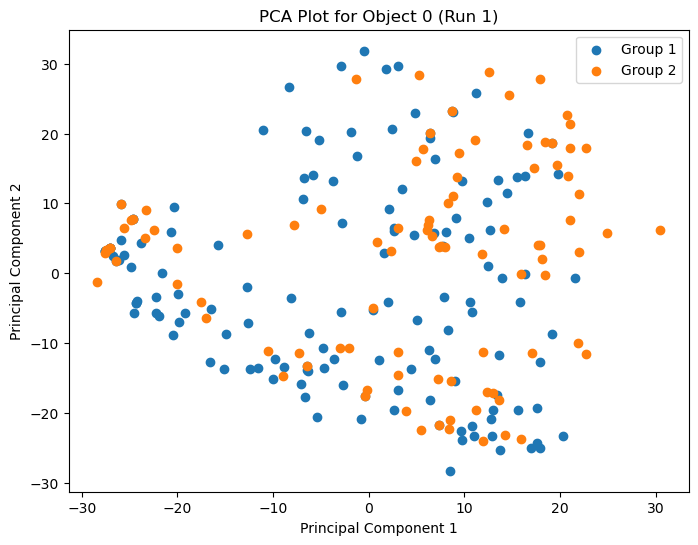

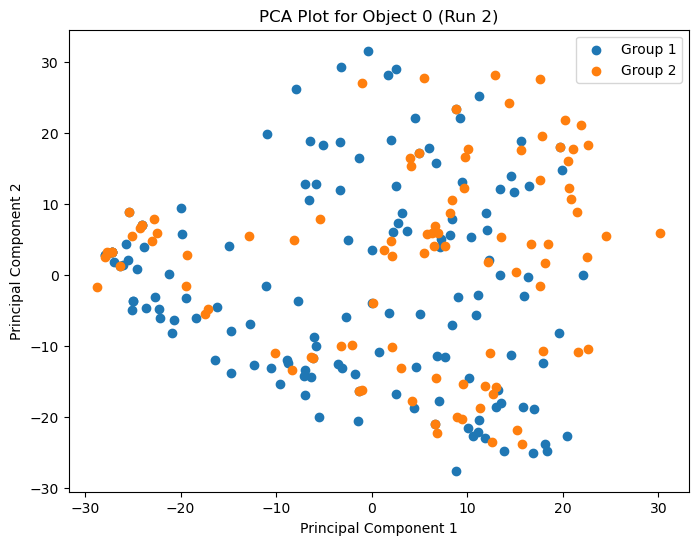

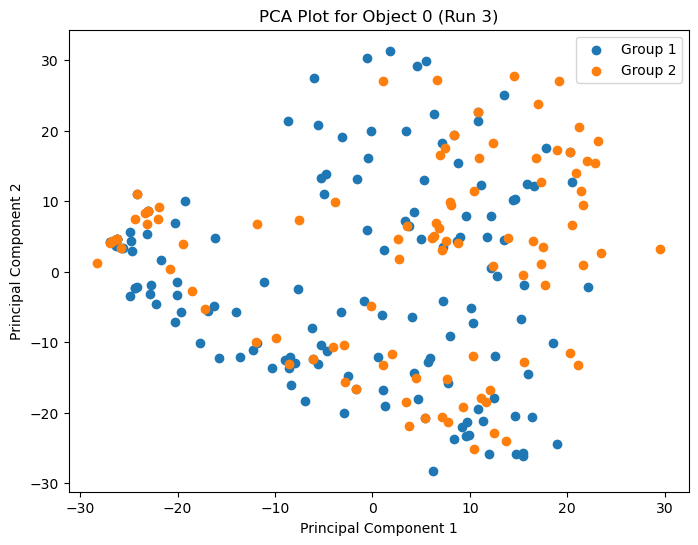

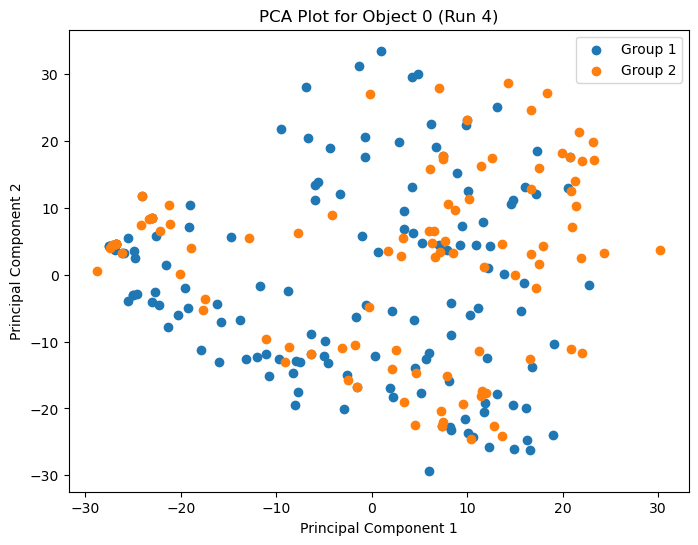

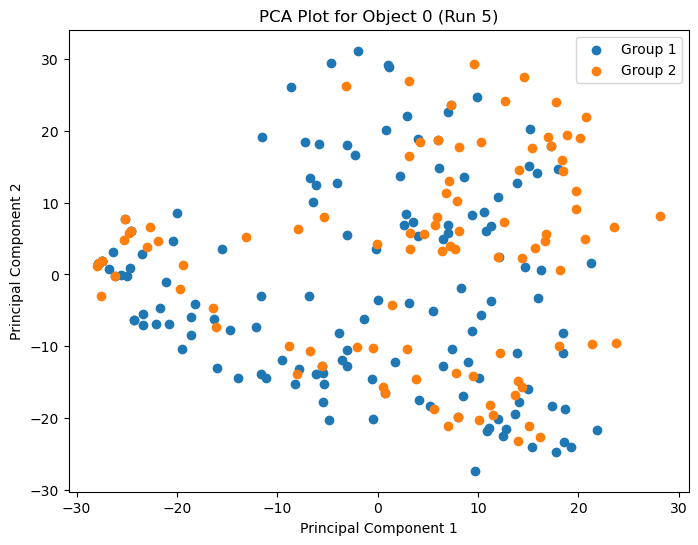

...

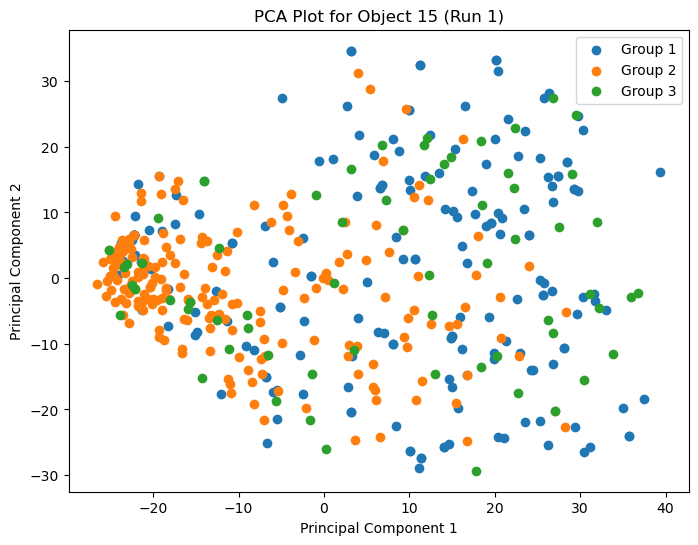

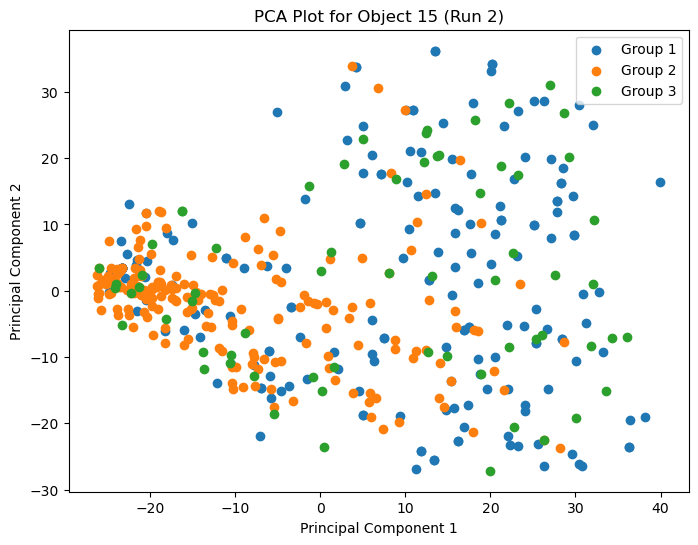

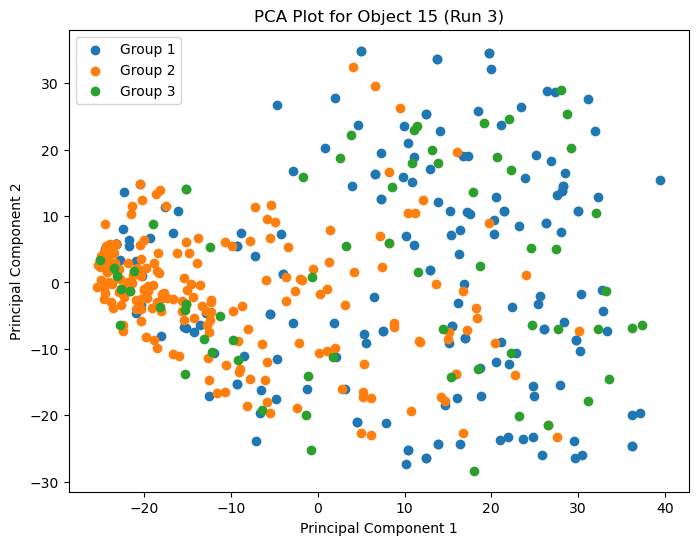

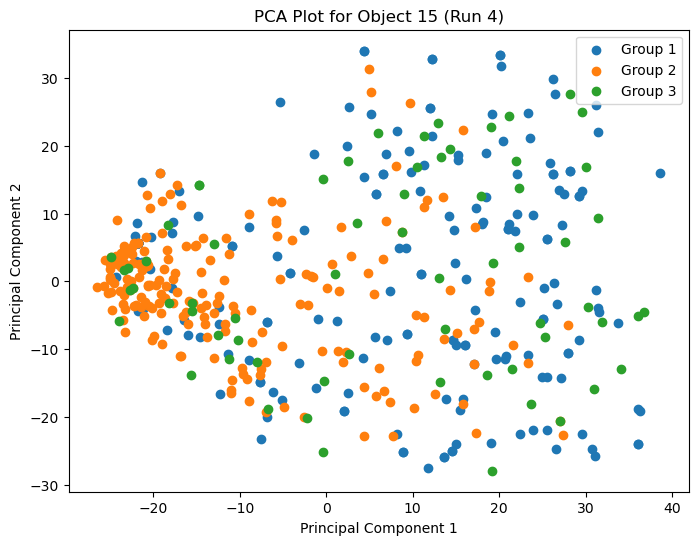

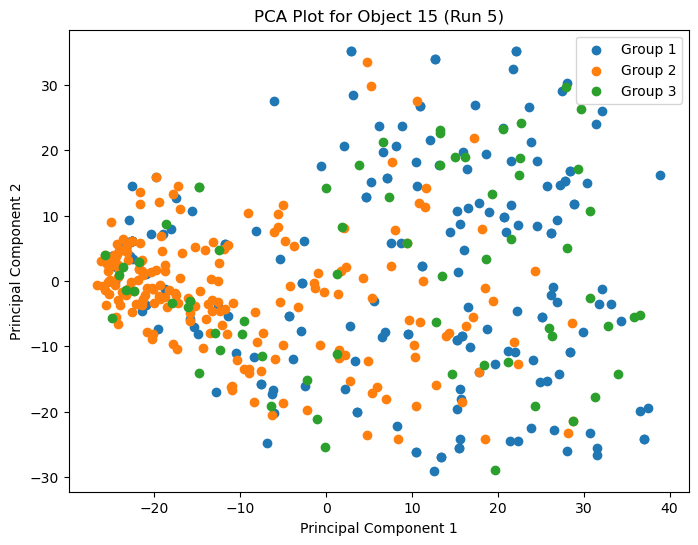

In [28]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from sktime.transformations.panel.rocket import MiniRocket
import matplotlib.pyplot as plt

# Helper function to pad time series
def pad_time_series(ts_list, min_length=9):
    padded = []
    for ts in ts_list:
        n_missing = max(0, min_length - len(ts))
        if n_missing > 0:
            padding = pd.DataFrame(0, index=range(n_missing), columns=ts.columns)
            ts = pd.concat([ts, padding], ignore_index=True)
        padded.append(ts)
    return padded

# Function to process and analyze each object
def analyze_objects(lst_car, n_runs=5):
    silhouette_results = []
    all_pca_results = []

    for obj_idx, obj in enumerate(lst_car):
        drivers = obj.drivers
        driver_groups = list(drivers.keys())
        
        # Prepare data and labels
        data = []
        labels = []
        for group in driver_groups:
            ts_list = [ts[["speed", "acceleration_est_1", "angular_acc"]] for ts in drivers[group]]
            ts_list = remove_outliers_with_3std(ts_list)
            ts_list = pad_time_series(ts_list, min_length=9)  # Pad shorter series
            data.extend(ts_list)
            labels.extend([group] * len(ts_list))

        if not data or not labels:
            print(f"Object {obj_idx}: Skipping due to empty data or labels.")
            continue

        silhouette_scores = []
        for seed in range(n_runs):
            # Initialize MiniRocket
            minirocket = MiniRocket(random_state=seed)

            # Ensure data is formatted correctly for MiniRocket
            if not isinstance(data, list) or not all(isinstance(ts, pd.DataFrame) for ts in data):
                print(f"Object {obj_idx}: Invalid data format. Skipping.")
                break

            # Transform data
            features = minirocket.fit_transform(data)

            # Apply PCA for visualization
            pca = PCA(n_components=5, random_state=seed)
            pca_result = pca.fit_transform(features)
            all_pca_results.append({
                'Object_ID': obj_idx,
                'Run': seed,
                'PCA_Data': pd.DataFrame({
                    'PC1': pca_result[:, 0],
                    'PC2': pca_result[:, 1],
                    'Group': labels
                })
            })

            # Calculate Silhouette Score
            if len(set(labels)) > 1:  # Ensure there are at least 2 groups
                silhouette_scores.append(silhouette_score(features, labels, metric='euclidean'))
            else:
                silhouette_scores.append(np.nan)

        # Calculate average silhouette score for the object
        avg_silhouette_score = np.nanmean(silhouette_scores)
        silhouette_results.append({'Object_ID': obj_idx, 'Average_Silhouette_Score': avg_silhouette_score})

    return pd.DataFrame(silhouette_results), all_pca_results

# Example usage
# lst_car should be provided as input
silhouette_df, pca_results = analyze_objects(lst_car, n_runs=5)

# Display silhouette scores
import ace_tools_open as tools
tools.display_dataframe_to_user(name="Silhouette Scores by Object", dataframe=silhouette_df)

# Plot PCA results
for pca_entry in pca_results:
    object_id = pca_entry['Object_ID']
    run = pca_entry['Run']
    pca_data = pca_entry['PCA_Data']

    plt.figure(figsize=(8, 6))
    for group in pca_data['Group'].unique():
        group_data = pca_data[pca_data['Group'] == group]
        plt.scatter(group_data['PC1'], group_data['PC2'], label=f'Group {group}')
    plt.title(f'PCA Plot for Object {object_id} (Run {run + 1})')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.legend()
    plt.show()


Object 5: Skipping due to empty data or labels.
Object 16: Skipping due to empty data or labels.
Silhouette Scores by Object


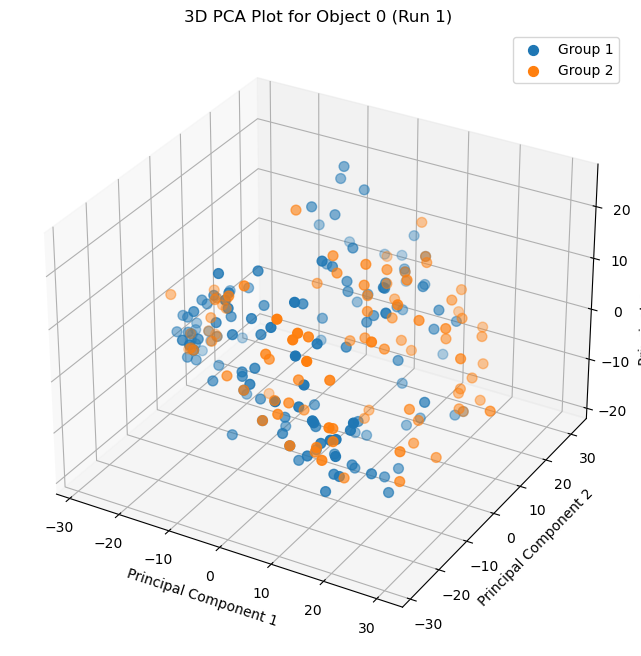

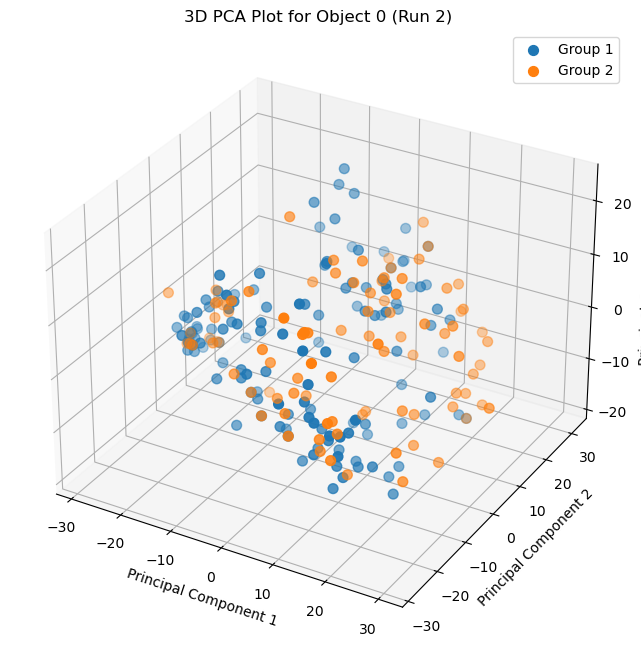

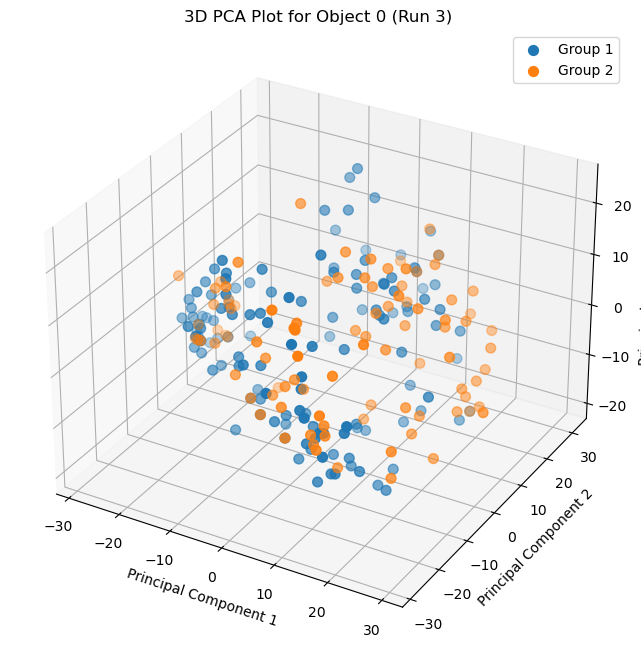

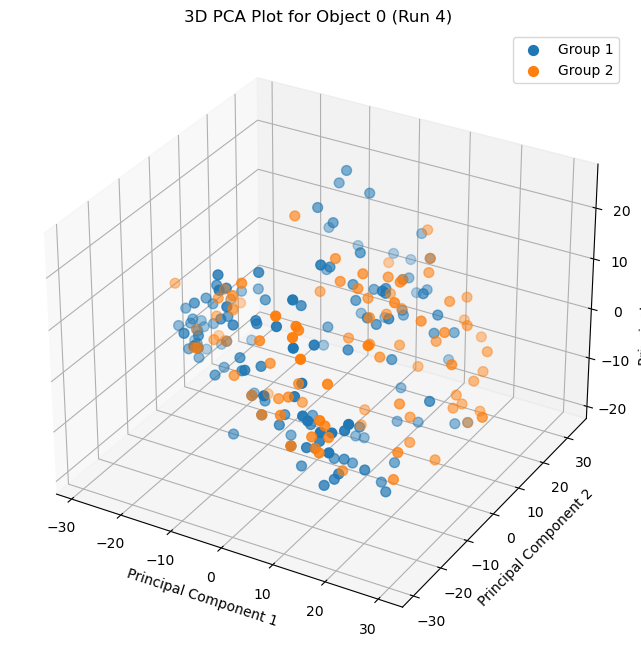

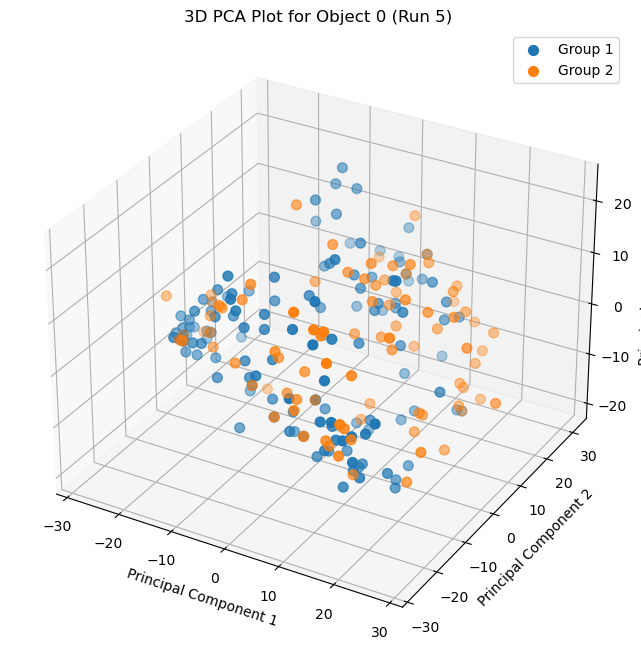

...

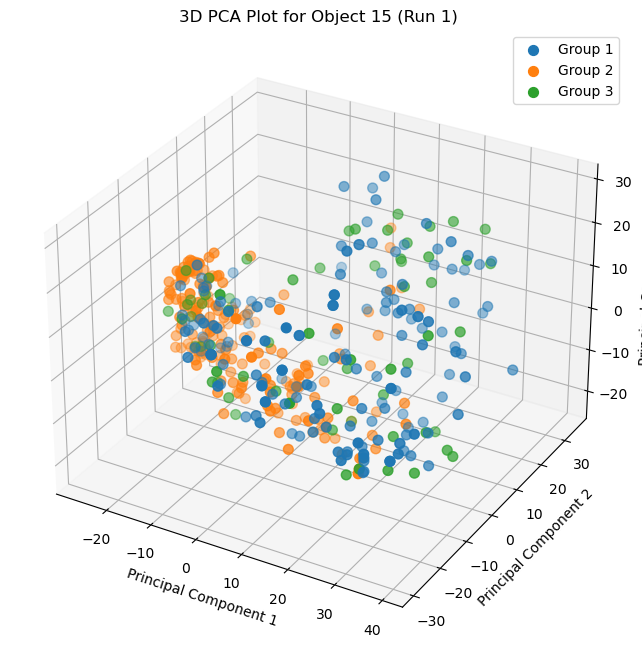

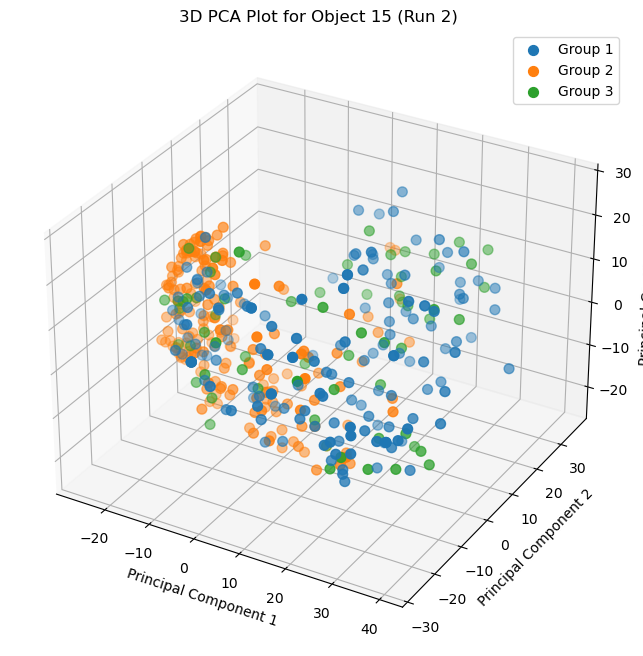

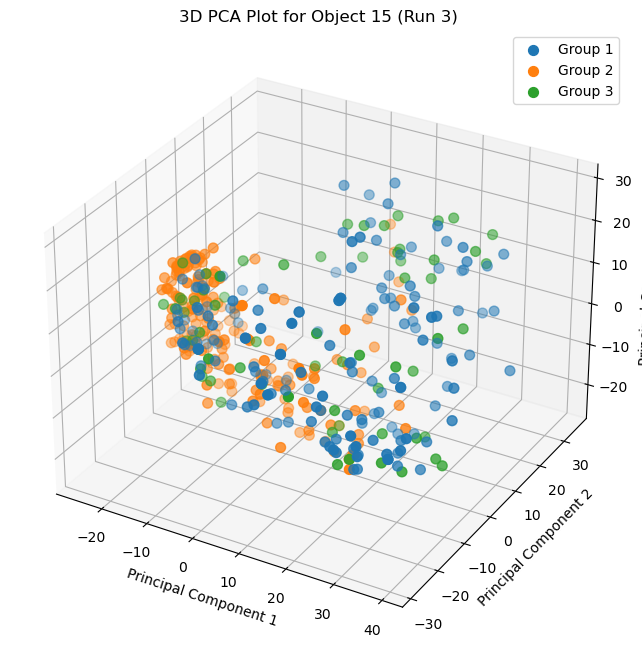

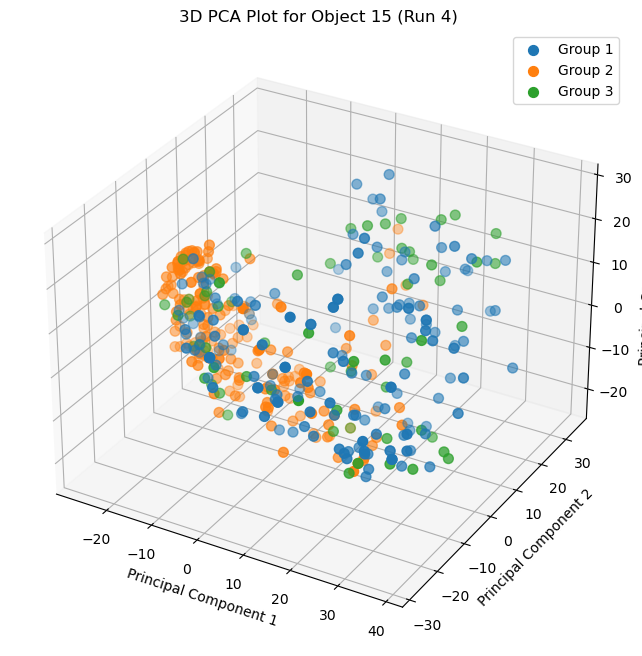

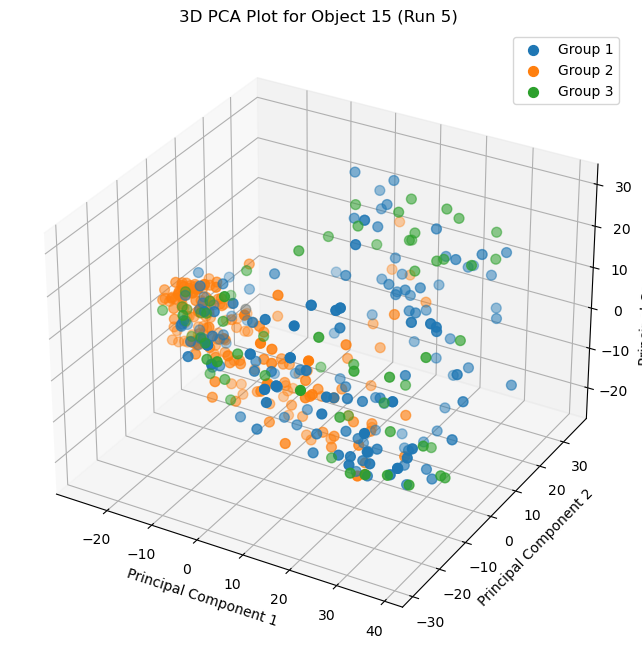

In [31]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from sktime.transformations.panel.rocket import MiniRocket
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # For 3D plotting

# Helper function to pad time series
def pad_time_series(ts_list, min_length=9):
    padded = []
    for ts in ts_list:
        n_missing = max(0, min_length - len(ts))
        if n_missing > 0:
            padding = pd.DataFrame(0, index=range(n_missing), columns=ts.columns)
            ts = pd.concat([ts, padding], ignore_index=True)
        padded.append(ts)
    return padded

# Function to process and analyze each object
def analyze_objects(lst_car, n_runs=20):
    silhouette_results = []
    all_pca_results = []

    for obj_idx, obj in enumerate(lst_car):
        drivers = obj.drivers
        driver_groups = list(drivers.keys())
        
        # Prepare data and labels
        data = []
        labels = []
        for group in driver_groups:
            ts_list = [ts[["speed", "acceleration_est_1", "angular_acc"]] for ts in drivers[group]]
            ts_list = remove_outliers_with_3std(ts_list)
            ts_list = pad_time_series(ts_list, min_length=9)  # Pad shorter series
            data.extend(ts_list)
            labels.extend([group] * len(ts_list))

        if not data or not labels:
            print(f"Object {obj_idx}: Skipping due to empty data or labels.")
            continue

        silhouette_scores = []
        for seed in range(n_runs):
            # Initialize MiniRocket
            minirocket = MiniRocket(random_state=seed)

            # Ensure data is formatted correctly for MiniRocket
            if not isinstance(data, list) or not all(isinstance(ts, pd.DataFrame) for ts in data):
                print(f"Object {obj_idx}: Invalid data format. Skipping.")
                break

            # Transform data
            features = minirocket.fit_transform(data)

            # Apply PCA for 5 components
            pca = PCA(n_components=5, random_state=seed)
            pca_result = pca.fit_transform(features)
            all_pca_results.append({
                'Object_ID': obj_idx,
                'Run': seed,
                'PCA_Data': pd.DataFrame({
                    'PC1': pca_result[:, 0],
                    'PC2': pca_result[:, 1],
                    'PC3': pca_result[:, 2],  # For 3D visualization
                    
                    'Group': labels
                })
            })

            # Calculate Silhouette Score
            if len(set(labels)) > 1:  # Ensure there are at least 2 groups
                silhouette_scores.append(silhouette_score(pca_result, labels, metric='euclidean'))
            else:
                silhouette_scores.append(np.nan)

        # Calculate average silhouette score for the object
        avg_silhouette_score = np.nanmean(silhouette_scores)
        silhouette_results.append({'Object_ID': obj_idx, 'Average_Silhouette_Score': avg_silhouette_score})

    return pd.DataFrame(silhouette_results), all_pca_results

# Example usage
# lst_car should be provided as input
silhouette_df, pca_results = analyze_objects(lst_car, n_runs=5)

# Display silhouette scores
import ace_tools_open as tools
tools.display_dataframe_to_user(name="Silhouette Scores by Object", dataframe=silhouette_df)

# # Plot 3D PCA results
# for pca_entry in pca_results:
#     object_id = pca_entry['Object_ID']
#     run = pca_entry['Run']
#     pca_data = pca_entry['PCA_Data']

#     fig = plt.figure(figsize=(10, 8))
#     ax = fig.add_subplot(111, projection='3d')
    
#     for group in pca_data['Group'].unique():
#         group_data = pca_data[pca_data['Group'] == group]
#         ax.scatter(group_data['PC1'], group_data['PC2'], group_data['PC3'], label=f'Group {group}', s=50)
    
#     ax.set_title(f'3D PCA Plot for Object {object_id} (Run {run + 1})')
#     ax.set_xlabel('Principal Component 1')
#     ax.set_ylabel('Principal Component 2')
#     ax.set_zlabel('Principal Component 3')
#     ax.legend()
#     plt.show()


In [32]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sktime.transformations.panel.rocket import MiniRocket
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # For 3D plotting

# Helper function to pad time series
def pad_time_series(ts_list, min_length=9):
    padded = []
    for ts in ts_list:
        n_missing = max(0, min_length - len(ts))
        if n_missing > 0:
            padding = pd.DataFrame(0, index=range(n_missing), columns=ts.columns)
            ts = pd.concat([ts, padding], ignore_index=True)
        padded.append(ts)
    return padded

# Function to calculate WCSS (Within-Cluster Sum of Squares)
def calculate_wcss(features, labels):
    wcss = 0
    for label in np.unique(labels):
        cluster_points = features[np.array(labels) == label]
        centroid = cluster_points.mean(axis=0)
        wcss += np.sum((cluster_points - centroid) ** 2)
    return wcss

# Function to process and analyze each object
def analyze_objects(lst_car, n_runs=5):
    clustering_results = []
    all_pca_results = []

    for obj_idx, obj in enumerate(lst_car):
        drivers = obj.drivers
        driver_groups = list(drivers.keys())
        
        # Prepare data and labels
        data = []
        labels = []
        for group in driver_groups:
            ts_list = [ts[["speed", "acceleration_est_1", "angular_acc"]] for ts in drivers[group]]
            ts_list = remove_outliers_with_3std(ts_list)
            ts_list = pad_time_series(ts_list, min_length=9)  # Pad shorter series
            data.extend(ts_list)
            labels.extend([group] * len(ts_list))

        if not data or not labels:
            print(f"Object {obj_idx}: Skipping due to empty data or labels.")
            continue

        silhouette_scores = []
        calinski_scores = []
        davies_scores = []
        wcss_scores = []

        for seed in range(n_runs):
            # Initialize MiniRocket
            minirocket = MiniRocket(random_state=seed)

            # Ensure data is formatted correctly for MiniRocket
            if not isinstance(data, list) or not all(isinstance(ts, pd.DataFrame) for ts in data):
                print(f"Object {obj_idx}: Invalid data format. Skipping.")
                break

            # Transform data
            features = minirocket.fit_transform(data)

            # Apply PCA for 5 components
            pca = PCA(n_components=5, random_state=seed)
            pca_result = pca.fit_transform(features)
            all_pca_results.append({
                'Object_ID': obj_idx,
                'Run': seed,
                'PCA_Data': pd.DataFrame({
                    'PC1': pca_result[:, 0],
                    'PC2': pca_result[:, 1],
                    'PC3': pca_result[:, 2],  # For 3D visualization
                    'Group': labels
                })
            })

            # Ensure valid clusters for metric calculations
            if len(set(labels)) > 1:
                # Silhouette Score
                silhouette_scores.append(silhouette_score(pca_result, labels, metric='euclidean'))
                
                # Calinski-Harabasz Index
                calinski_scores.append(calinski_harabasz_score(pca_result, labels))
                
                # Davies-Bouldin Index
                davies_scores.append(davies_bouldin_score(pca_result, labels))
                
                # WCSS
                wcss_scores.append(calculate_wcss(pca_result, labels))
            else:
                silhouette_scores.append(np.nan)
                calinski_scores.append(np.nan)
                davies_scores.append(np.nan)
                wcss_scores.append(np.nan)

        # Aggregate metrics
        clustering_results.append({
            'Object_ID': obj_idx,
            'Avg_Silhouette_Score': np.nanmean(silhouette_scores),
            'Avg_Calinski_Harabasz_Score': np.nanmean(calinski_scores),
            'Avg_Davies_Bouldin_Score': np.nanmean(davies_scores),
            'Avg_WCSS': np.nanmean(wcss_scores)
        })

    return pd.DataFrame(clustering_results), all_pca_results

# Example usage
# lst_car should be provided as input
clustering_df, pca_results = analyze_objects(lst_car, n_runs=5)

# Display clustering results
import ace_tools_open as tools
tools.display_dataframe_to_user(name="Clustering Metrics by Object", dataframe=clustering_df)

# Plot 3D PCA results
# for pca_entry in pca_results:
#     object_id = pca_entry['Object_ID']
#     run = pca_entry['Run']
#     pca_data = pca_entry['PCA_Data']

#     fig = plt.figure(figsize=(10, 8))
#     ax = fig.add_subplot(111, projection='3d')
    
#     for group in pca_data['Group'].unique():
#         group_data = pca_data[pca_data['Group'] == group]
#         ax.scatter(group_data['PC1'], group_data['PC2'], group_data['PC3'], label=f'Group {group}', s=50)
    
#     ax.set_title(f'3D PCA Plot for Object {object_id} (Run {run + 1})')
#     ax.set_xlabel('Principal Component 1')
#     ax.set_ylabel('Principal Component 2')
#     ax.set_zlabel('Principal Component 3')
#     ax.legend()
#     plt.show()


Object 5: Skipping due to empty data or labels.
Object 16: Skipping due to empty data or labels.
Clustering Metrics by Object


In [116]:
# lst_2 = remove_outliers_with_dbscan(groups_splitted_normlized_ts[2])
# lst_1 = remove_outliers_with_dbscan(groups_splitted_normlized_ts[1])
lst_2 = groups_splitted_normlized_ts[2]
lst_1 = groups_splitted_normlized_ts[1]
for s in lst_2:
    s["group"] = 2
for s in lst_1:
    s["group"] = 1
lst = lst_2 + lst_1

length_of_ts_dict = {}
for series in lst:
    length = len(series)
    
    length_of_ts_dict[length] = length_of_ts_dict.get(length,[])
    length_of_ts_dict[length].append(series)

In [117]:
length_of_ts_dict.keys()

dict_keys([11, 8, 7, 17, 9, 10, 15, 14, 16, 18, 20, 12, 21, 19, 6, 13, 23, 22, 24])

In [32]:
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.cm as cm
import numpy as np

def plot_multi_dimensional_time_series(dfs):
    """
    Plots a multi-dimensional time series DataFrame.
    
    Parameters:
    dfs (list of pd.DataFrame): The list of DataFrames containing the time series data. Each column is a feature.
    
    Returns:
    None
    """
    # Reset index of each DataFrame
    for df in dfs:
        df.reset_index(inplace=True, drop=True)
    
    # Define the columns to plot
    columns_to_plot = ['speed', 'acceleration_est_1', 'angular_acc']
    
    # Get unique groups
    unique_groups = [1,2,3,4,5,6]
    
    # Create a colormap
    colors = cm.get_cmap('viridis', len(unique_groups))
    
    # Plot each column
    for column in columns_to_plot:
        plt.figure(figsize=(12, 6))
        
        # Set to keep track of groups already plotted for the legend
        plotted_groups = set()
        
        for df in dfs:
            groups = df['group'].unique()
            for group in groups:
                group_df = df[df['group'] == group]
                color = colors(group - 1)  # Group values are assumed to be 1 to 6
                
                if group not in plotted_groups:
                    plt.plot(group_df.index, group_df[column], label=f'Group {group}', color=color)
                    plotted_groups.add(group)
                else:
                    plt.plot(group_df.index, group_df[column], color=color)
        
        plt.xlabel('Row Number')
        plt.ylabel('Value')
        plt.title(column)
        plt.legend()
        plt.grid(True)
        plt.show()


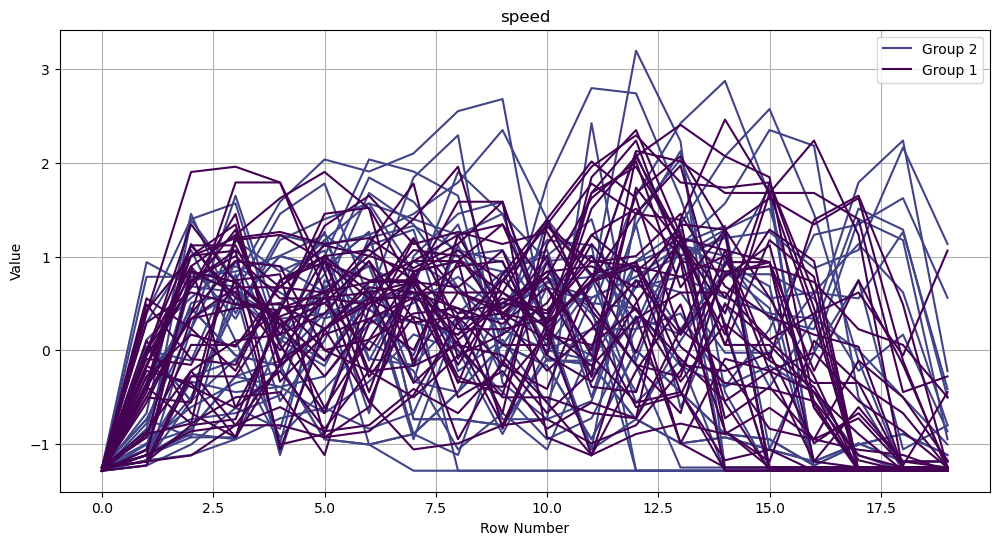

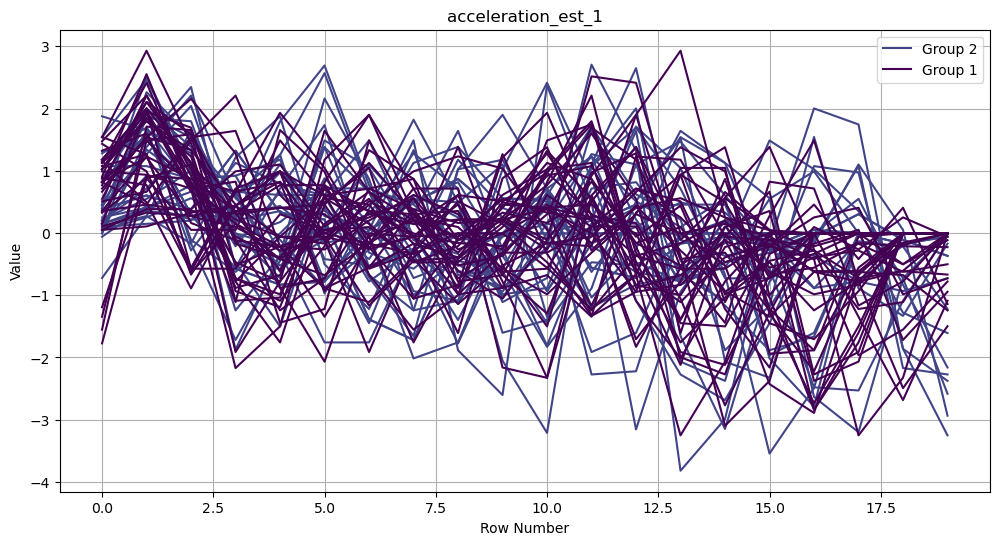

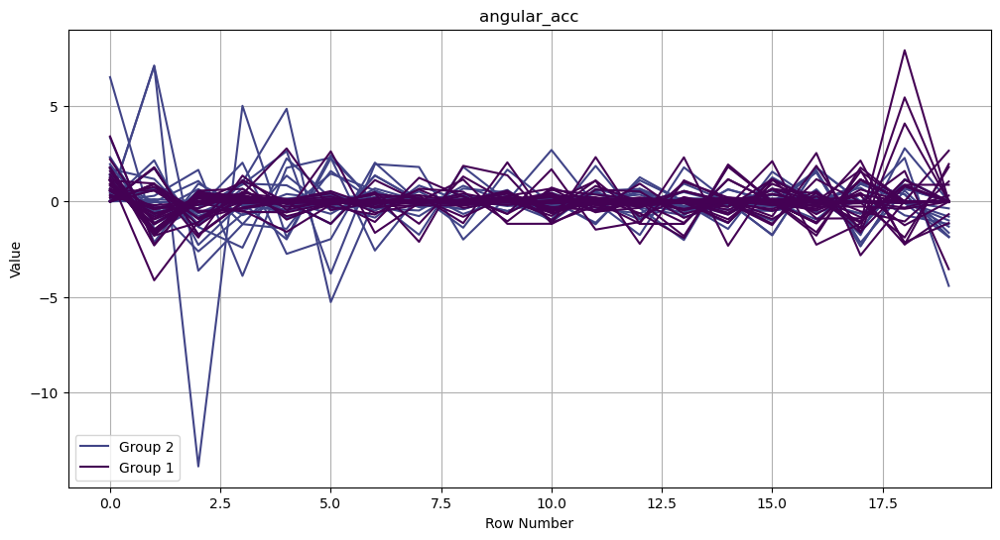

In [120]:
plot_multi_dimensional_time_series(length_of_ts_dict[20])